<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Librerías" data-toc-modified-id="Librerías-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Librerías</a></span></li><li><span><a href="#Preparación-de-los-datos" data-toc-modified-id="Preparación-de-los-datos-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Preparación de los datos</a></span><ul class="toc-item"><li><span><a href="#Set-de-datos-1:-media-ponderada" data-toc-modified-id="Set-de-datos-1:-media-ponderada-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Set de datos 1: media ponderada</a></span></li><li><span><a href="#Set-de-datos-2" data-toc-modified-id="Set-de-datos-2-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Set de datos 2</a></span></li></ul></li><li><span><a href="#Clustering" data-toc-modified-id="Clustering-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Clustering</a></span><ul class="toc-item"><li><span><a href="#Clustering-con-el-subset-de-datos-1" data-toc-modified-id="Clustering-con-el-subset-de-datos-1-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Clustering con el subset de datos 1</a></span><ul class="toc-item"><li><span><a href="#Método-Elbow" data-toc-modified-id="Método-Elbow-3.1.1"><span class="toc-item-num">3.1.1&nbsp;&nbsp;</span>Método Elbow</a></span></li><li><span><a href="#Método-Silhouette" data-toc-modified-id="Método-Silhouette-3.1.2"><span class="toc-item-num">3.1.2&nbsp;&nbsp;</span>Método Silhouette</a></span></li><li><span><a href="#Clusterización-con-k-=-2" data-toc-modified-id="Clusterización-con-k-=-2-3.1.3"><span class="toc-item-num">3.1.3&nbsp;&nbsp;</span>Clusterización con k = 2</a></span></li><li><span><a href="#Clusterización-con-k-=-3" data-toc-modified-id="Clusterización-con-k-=-3-3.1.4"><span class="toc-item-num">3.1.4&nbsp;&nbsp;</span>Clusterización con k = 3</a></span></li></ul></li><li><span><a href="#Clustering-con-el-subset-de-datos-2" data-toc-modified-id="Clustering-con-el-subset-de-datos-2-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Clustering con el subset de datos 2</a></span><ul class="toc-item"><li><span><a href="#Método-Elbow" data-toc-modified-id="Método-Elbow-3.2.1"><span class="toc-item-num">3.2.1&nbsp;&nbsp;</span>Método Elbow</a></span></li><li><span><a href="#Método-Silhouette" data-toc-modified-id="Método-Silhouette-3.2.2"><span class="toc-item-num">3.2.2&nbsp;&nbsp;</span>Método Silhouette</a></span></li><li><span><a href="#Clusterización-con-k-=-2" data-toc-modified-id="Clusterización-con-k-=-2-3.2.3"><span class="toc-item-num">3.2.3&nbsp;&nbsp;</span>Clusterización con k = 2</a></span></li><li><span><a href="#Clusterización-con-k-=-5" data-toc-modified-id="Clusterización-con-k-=-5-3.2.4"><span class="toc-item-num">3.2.4&nbsp;&nbsp;</span>Clusterización con k = 5</a></span></li></ul></li><li><span><a href="#Clusterización-basada-en-la-frecuencia-de-ratings" data-toc-modified-id="Clusterización-basada-en-la-frecuencia-de-ratings-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>Clusterización basada en la frecuencia de ratings</a></span></li><li><span><a href="#PCA" data-toc-modified-id="PCA-3.4"><span class="toc-item-num">3.4&nbsp;&nbsp;</span>PCA</a></span></li></ul></li><li><span><a href="#Gaussian-Mixture" data-toc-modified-id="Gaussian-Mixture-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Gaussian Mixture</a></span></li><li><span><a href="#Clusterización-final" data-toc-modified-id="Clusterización-final-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Clusterización final</a></span><ul class="toc-item"><li><span><a href="#Decision-Tree" data-toc-modified-id="Decision-Tree-5.1"><span class="toc-item-num">5.1&nbsp;&nbsp;</span>Decision Tree</a></span></li><li><span><a href="#Sistema-de-recomendacion" data-toc-modified-id="Sistema-de-recomendacion-5.2"><span class="toc-item-num">5.2&nbsp;&nbsp;</span>Sistema de recomendacion</a></span></li></ul></li></ul></div>

<h1>Ejercicio 7.2 - Cluestering<span class="tocSkip"></span></h1>
<h3>Marc Jovaní y Laura Oliva<span class="tocSkip"></span></h3>

El objetivo del presente trabajo es realizar una clusterización de los clientes de una plataforma de películas online, basándonos en las puntuaciones que han dado a diferentes películas, para finalmente crear un sistema de recomendaciones de películas en función de la clusterización realizada. 

# Librerías

In [1]:
# Librerías para el tratamiento de datos
import numpy as np
import pandas as pd

# Librerías para la visualización de datos
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns

# Librerías para el modelado de datos
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture

from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
from sklearn import tree
from sklearn.model_selection import train_test_split

# Preparación de los datos

In [2]:
# Empezamos por el fichero de movies

movies = pd.read_csv("./data/original_data/movies.csv")
movies.head()

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


In [3]:
# Necesitamos asignar cada tag (género) a una columna y posteriormente asignar un valor a la presencia o ausencia de cada tag. 
# Primero, creamos una copia y cambiamos la columna de géneros para que nos los muestre como una lista

movies_cleaned = movies.copy()
movies_cleaned["genres"] = movies_cleaned["genres"].apply(lambda x: x.split("|"))

movies_cleaned.head()

,movieId,title,genres
0,1,Toy Story (1995),"[Adventure, Animation, Children, Comedy, Fantasy]"
1,2,Jumanji (1995),"[Adventure, Children, Fantasy]"
2,3,Grumpier Old Men (1995),"[Comedy, Romance]"
3,4,Waiting to Exhale (1995),"[Comedy, Drama, Romance]"
4,5,Father of the Bride Part II (1995),[Comedy]


In [4]:
# Creamos un set con todos los géneros

genres = set()
for row in movies_cleaned["genres"]:
    for genre in row:
        genres.add(genre)

genres.remove('(no genres listed)')

genres

{'Action',
 'Adventure',
 'Animation',
 'Children',
 'Comedy',
 'Crime',
 'Documentary',
 'Drama',
 'Fantasy',
 'Film-Noir',
 'Horror',
 'IMAX',
 'Musical',
 'Mystery',
 'Romance',
 'Sci-Fi',
 'Thriller',
 'War',
 'Western'}

In [5]:
# Para cada género cremos una columna indicando si la película tiene ese género con 1 y 0 si no lo tiene

for genre in genres:
    movies_cleaned[genre] = movies_cleaned["genres"].apply(lambda x: 1 if genre in x else 0)

# Y eliminamos la columna original
movies_cleaned = movies_cleaned.drop(columns = ["genres"])

movies_cleaned.head()

,movieId,title,Film-Noir,Adventure,Children,Sci-Fi,Crime,Fantasy,Western,War,...,IMAX,Romance,Comedy,Action,Musical,Horror,Mystery,Drama,Thriller,Documentary
0,1,Toy Story (1995),0,1,1,0,0,1,0,0,...,0,0,1,0,0,0,0,0,0,0
1,2,Jumanji (1995),0,1,1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,3,Grumpier Old Men (1995),0,0,0,0,0,0,0,0,...,0,1,1,0,0,0,0,0,0,0
3,4,Waiting to Exhale (1995),0,0,0,0,0,0,0,0,...,0,1,1,0,0,0,0,1,0,0
4,5,Father of the Bride Part II (1995),0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0


Tenemos el fichero *movies* preparado, con 21 columnas: el *id* de cada película, su título y los géneros a los que pertenece.
A continuación preparamos el fichero de *ratings*, que contiene las puntuaciones que cada usuario a asignado a una película.

In [6]:
# Leemos el fichero de ratings

ratings = pd.read_csv("./data/original_data/ratings.csv")
ratings.head()

,userId,movieId,rating,timestamp
0,1,1,4.0,964982703
1,1,3,4.0,964981247
2,1,6,4.0,964982224
3,1,47,5.0,964983815
4,1,50,5.0,964982931


In [7]:
# Juntamos el dataframe de ratings y de movies con un left join y a través del campo común "movieId"

df = pd.merge(ratings, movies_cleaned, how = 'left', on = 'movieId')

In [8]:
df.head()

,userId,movieId,rating,timestamp,title,Film-Noir,Adventure,Children,Sci-Fi,Crime,...,IMAX,Romance,Comedy,Action,Musical,Horror,Mystery,Drama,Thriller,Documentary
0,1,1,4.0,964982703,Toy Story (1995),0,1,1,0,0,...,0,0,1,0,0,0,0,0,0,0
1,1,3,4.0,964981247,Grumpier Old Men (1995),0,0,0,0,0,...,0,1,1,0,0,0,0,0,0,0
2,1,6,4.0,964982224,Heat (1995),0,0,0,0,1,...,0,0,0,1,0,0,0,0,1,0
3,1,47,5.0,964983815,Seven (a.k.a. Se7en) (1995),0,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
4,1,50,5.0,964982931,"Usual Suspects, The (1995)",0,0,0,0,1,...,0,0,0,0,0,0,1,0,1,0


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100836 entries, 0 to 100835
Data columns (total 24 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   userId       100836 non-null  int64  
 1   movieId      100836 non-null  int64  
 2   rating       100836 non-null  float64
 3   timestamp    100836 non-null  int64  
 4   title        100836 non-null  object 
 5   Film-Noir    100836 non-null  int64  
 6   Adventure    100836 non-null  int64  
 7   Children     100836 non-null  int64  
 8   Sci-Fi       100836 non-null  int64  
 9   Crime        100836 non-null  int64  
 10  Fantasy      100836 non-null  int64  
 11  Western      100836 non-null  int64  
 12  War          100836 non-null  int64  
 13  Animation    100836 non-null  int64  
 14  IMAX         100836 non-null  int64  
 15  Romance      100836 non-null  int64  
 16  Comedy       100836 non-null  int64  
 17  Action       100836 non-null  int64  
 18  Musical      100836 non-

Vemos que tenemos un dataframe con 100.836 registros, sin valores nulos, y con todas las columnas numéricas excepto el título de la película, la cual podemos quitar ya que tenemos el movieId para identificar las películas. Quitamos también la columna timestamp, puesto que la fecha en que un usuario ha hecho una valoración no es relevante para la posterior clusterización.

In [10]:
df = df.drop(columns = ['title', 'timestamp'])

In [11]:
# Vemos cómo ha quedado nuestro dataframe
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100836 entries, 0 to 100835
Data columns (total 22 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   userId       100836 non-null  int64  
 1   movieId      100836 non-null  int64  
 2   rating       100836 non-null  float64
 3   Film-Noir    100836 non-null  int64  
 4   Adventure    100836 non-null  int64  
 5   Children     100836 non-null  int64  
 6   Sci-Fi       100836 non-null  int64  
 7   Crime        100836 non-null  int64  
 8   Fantasy      100836 non-null  int64  
 9   Western      100836 non-null  int64  
 10  War          100836 non-null  int64  
 11  Animation    100836 non-null  int64  
 12  IMAX         100836 non-null  int64  
 13  Romance      100836 non-null  int64  
 14  Comedy       100836 non-null  int64  
 15  Action       100836 non-null  int64  
 16  Musical      100836 non-null  int64  
 17  Horror       100836 non-null  int64  
 18  Mystery      100836 non-

Vamos a probar dos abordajes: 
1. Vamos a agrupar las películas por el userId, sin tener en cuenta el movieId, cogiendo la media de ratings y una media ponderada segun el rating para cada género y teniendo en cuenta el total de películas de cada género (esto es, si un usuario no ha puntuado una película, ésta se incluirá igualmente para calcular la media como si la puntuación hubiera sido 0). Es decir, en cada fila tendremos un userId junto con la media ponderada de sus ratings para cada género. La media ponderada premiara los generos con una puntuacion superior a 2 estrellas y penelizara las que esten por debajo, podriamos elevar el peso al cuadrado para dar mas peso a los extremos pero no lo creemos necesario por ahora.
2. Vamos a agrupar la películas por userId, sin tener en cuenta el movieId, pero esta vez calcularemos una media para cada usuario y género teniendo en cuenta únicamente las películas que haya puntuado el usuario en cada género. 

## Set de datos 1: media ponderada

In [12]:
# Buscamos filas duplicadas
df.duplicated().sum()

0

In [13]:
# Definimos una función que calculará las medias ponderadas de los ratings para cada género
wm = lambda x: np.average(x, weights = (df.loc[x.index, 'rating'])**2)

agg_dict = {} #{'genre': 'mean'}
for genre in genres:
    agg_dict[genre] = wm

# Lo aplicamos al dataframe agrupando por usuario
df2 = df.drop(columns = ['movieId']).groupby(['userId']).agg(agg_dict)

In [14]:
# Vemos el resultado
df2.head()

,Film-Noir,Adventure,Children,Sci-Fi,Crime,Fantasy,Western,War,Animation,IMAX,Romance,Comedy,Action,Musical,Horror,Mystery,Drama,Thriller,Documentary
userId,,,,,,,,,,,,,,,,,,,
1,0.005469,0.368191,0.194487,0.161234,0.193393,0.196456,0.028878,0.099541,0.141763,0.000000,0.107635,0.343251,0.379129,0.107416,0.048786,0.074163,0.312842,0.218333,0.000000
2,0.000000,0.113238,0.000000,0.132376,0.321106,0.000000,0.026050,0.043062,0.000000,0.122275,0.043062,0.246677,0.372674,0.000000,0.019139,0.068049,0.567783,0.306220,0.125465
3,0.000000,0.305660,0.003145,0.729560,0.001258,0.145283,0.000000,0.003145,0.002516,0.000000,0.003145,0.067925,0.562264,0.000629,0.444654,0.062893,0.060377,0.343396,0.000000
4,0.022566,0.142489,0.050935,0.041264,0.138943,0.095422,0.050290,0.035139,0.032237,0.002901,0.251451,0.464539,0.104126,0.088330,0.023533,0.102515,0.536428,0.176983,0.010961
5,0.000000,0.147436,0.251603,0.020833,0.294872,0.200321,0.041667,0.067308,0.185897,0.068910,0.192308,0.307692,0.147436,0.160256,0.014423,0.025641,0.620192,0.192308,0.000000


In [15]:
# Vemos los estadísticos
df2.describe()

,Film-Noir,Adventure,Children,Sci-Fi,Crime,Fantasy,Western,War,Animation,IMAX,Romance,Comedy,Action,Musical,Horror,Mystery,Drama,Thriller,Documentary
count,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000
mean,0.007846,0.256847,0.089238,0.170723,0.185888,0.114053,0.021307,0.063402,0.072593,0.048513,0.187079,0.343841,0.310151,0.040861,0.058776,0.079858,0.450196,0.278324,0.009338
std,0.015993,0.137690,0.086751,0.117466,0.101781,0.084491,0.027991,0.053010,0.080956,0.064446,0.109511,0.148944,0.159400,0.048483,0.072711,0.050979,0.151352,0.125768,0.025171
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002370,0.000000,0.000000
25%,0.000000,0.161623,0.030499,0.086913,0.119986,0.060329,0.000000,0.029429,0.018974,0.000433,0.110625,0.239825,0.203582,0.004772,0.021996,0.046295,0.347912,0.191847,0.000000
50%,0.000000,0.241608,0.067684,0.153242,0.174371,0.103063,0.013847,0.052673,0.051659,0.027469,0.171222,0.334360,0.295797,0.026204,0.042470,0.074729,0.453317,0.273778,0.000000
75%,0.008582,0.332904,0.128079,0.221674,0.237230,0.148474,0.030118,0.087084,0.102643,0.066212,0.246103,0.417524,0.407896,0.059292,0.073417,0.103108,0.545496,0.358747,0.008168
max,0.106415,0.872014,0.772512,0.948473,0.705197,0.795928,0.312028,0.528428,0.742268,0.520478,0.883148,0.940147,0.923191,0.382597,0.886667,0.381657,0.932107,0.902156,0.368421


<AxesSubplot:>

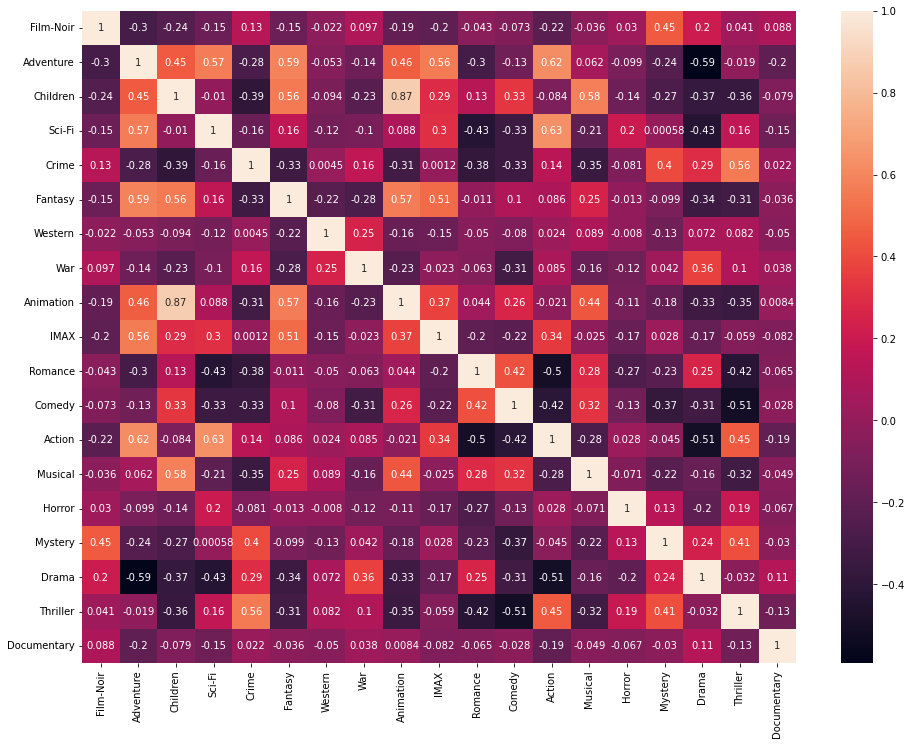

In [16]:
# Ploteamos la matrix de correlacion

plt.figure(figsize = (16, 12))
sns.heatmap(df2.corr(), annot = True)

Como podemos ver en los estadísticos, ningún género obtiene una puntuación superior a 1 para ningún usuario. Esto probablemente se deba a que la proporción de películas de un género que un usuario haya puntuado es un proporción muy pequeña del total de películas para ese género, por lo que al calcular la media teniendo en cuenta las películas no puntuadas, el valor del rating para el género disminuye mucho. 
En cuanto a las correlaciones, las únicas columnas significativamente correlacionadas son la de Children y Animation, cosa que tiene sentido, si bien la correlación no es lo suficientemente alta como para eliminar una de las dos.

## Set de datos 2

Vamos a probar a calcular las medias por género y usuario teniendo en cuanta únicamente las películas que el usuario hay puntuado. De esta forma obtenedremos medias de ratings más distribuidas en el rango de ratings (0.5-5)- Para ello, primero hemos de calcular las frecuencias acumuladas para cada género y usuario, después la media de sus puntuaciones, y finalmente la media. 

In [17]:
# Como para cada género el valor puede ser 0 o 1, con la función sum sacamos el acumulado para cada usuario y género
frequencies = df.drop(columns = (['movieId', 'rating'])).groupby(['userId']).sum()
frequencies.head()

,Film-Noir,Adventure,Children,Sci-Fi,Crime,Fantasy,Western,War,Animation,IMAX,Romance,Comedy,Action,Musical,Horror,Mystery,Drama,Thriller,Documentary
userId,,,,,,,,,,,,,,,,,,,
1,1,85,42,40,45,47,7,22,29,0,26,83,90,22,17,18,68,55,0
2,0,3,0,4,10,0,1,1,0,4,1,7,11,0,1,2,17,10,3
3,0,11,5,15,2,4,0,5,4,0,5,9,14,1,8,1,16,7,0
4,4,29,10,12,27,19,10,7,6,1,58,104,25,16,4,23,120,38,2
5,0,8,9,2,12,7,2,3,6,3,11,15,9,5,1,1,25,9,0


In [18]:
# Definimos una función para calcular el rating total por cada usuario y género
get_ratings = lambda x: np.sum(x * df.loc[x.index, 'rating'])

agg_dict = {} #{'genre: rating'}
for genre in genres:
    agg_dict[genre] = get_ratings

# Lo aplicamos agrupando por género
ratings = df.drop(columns = ['movieId']).groupby(['userId']).agg(agg_dict)

In [19]:
# Vemos el resultado
ratings.head()

,Film-Noir,Adventure,Children,Sci-Fi,Crime,Fantasy,Western,War,Animation,IMAX,Romance,Comedy,Action,Musical,Horror,Mystery,Drama,Thriller,Documentary
userId,,,,,,,,,,,,,,,,,,,
1,5.0,373.0,191.0,169.0,196.0,202.0,30.0,99.0,136.0,0.0,112.0,355.0,389.0,103.0,59.0,75.0,308.0,228.0,0.0
2,0.0,12.5,0.0,15.5,38.0,0.0,3.5,4.5,0.0,15.0,4.5,28.0,43.5,0.0,3.0,8.0,66.0,37.0,13.0
3,0.0,30.0,2.5,63.0,1.0,13.5,0.0,2.5,2.0,0.0,2.5,9.0,50.0,0.5,37.5,5.0,12.0,29.0,0.0
4,16.0,106.0,38.0,34.0,103.0,70.0,38.0,25.0,24.0,3.0,196.0,365.0,83.0,64.0,17.0,80.0,418.0,135.0,8.0
5,0.0,26.0,37.0,5.0,46.0,29.0,6.0,10.0,26.0,11.0,34.0,52.0,28.0,22.0,3.0,4.0,95.0,32.0,0.0


In [20]:
# Obtenemos el dataframe con las medias de ratings por género y usuario
df3 = round(ratings/frequencies, 2)
df3.head()

,Film-Noir,Adventure,Children,Sci-Fi,Crime,Fantasy,Western,War,Animation,IMAX,Romance,Comedy,Action,Musical,Horror,Mystery,Drama,Thriller,Documentary
userId,,,,,,,,,,,,,,,,,,,
1,5.0,4.39,4.55,4.22,4.36,4.30,4.29,4.50,4.69,NaN,4.31,4.28,4.32,4.68,3.47,4.17,4.53,4.15,NaN
2,NaN,4.17,NaN,3.88,3.80,NaN,3.50,4.50,NaN,3.75,4.50,4.00,3.95,NaN,3.00,4.00,3.88,3.70,4.33
3,NaN,2.73,0.50,4.20,0.50,3.38,NaN,0.50,0.50,NaN,0.50,1.00,3.57,0.50,4.69,5.00,0.75,4.14,NaN
4,4.0,3.66,3.80,2.83,3.81,3.68,3.80,3.57,4.00,3.00,3.38,3.51,3.32,4.00,4.25,3.48,3.48,3.55,4.00
5,NaN,3.25,4.11,2.50,3.83,4.14,3.00,3.33,4.33,3.67,3.09,3.47,3.11,4.40,3.00,4.00,3.80,3.56,NaN


In [21]:
# Reemplazamos los nulos por 0 para el posterior entrenamiento. Si bien ello penalizará los géneros no puntuados por un usuario,
# Podemos deducir que si un usuario no ha puntuado nunca un género, será porque no le interesa ese género. 
# Vemos los principales estadísticos del nuevo dataframe
df3 = df3.fillna(0)
df3.describe()

,Film-Noir,Adventure,Children,Sci-Fi,Crime,Fantasy,Western,War,Animation,IMAX,Romance,Comedy,Action,Musical,Horror,Mystery,Drama,Thriller,Documentary
count,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000,610.000000
mean,1.508262,3.593754,3.198016,3.503443,3.714738,3.412508,2.507934,3.496230,3.144607,2.857672,3.614951,3.562049,3.544770,2.765885,3.030459,3.574508,3.756738,3.618311,1.381787
std,1.943701,0.661736,1.239336,0.751212,0.744412,1.003291,1.814156,1.330698,1.450404,1.772597,0.691478,0.564129,0.631665,1.663690,1.384890,1.065050,0.531123,0.625678,1.893903
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.750000,0.000000,0.000000
25%,0.000000,3.280000,3.000000,3.200000,3.415000,3.092500,0.000000,3.315000,3.000000,0.500000,3.250000,3.250000,3.240000,2.000000,2.670000,3.265000,3.460000,3.310000,0.000000
50%,0.000000,3.650000,3.500000,3.590000,3.800000,3.555000,3.250000,3.895000,3.615000,3.535000,3.685000,3.590000,3.600000,3.400000,3.430000,3.750000,3.820000,3.670000,0.000000
75%,3.750000,4.000000,4.000000,4.000000,4.170000,4.000000,4.000000,4.270000,4.000000,4.000000,4.050000,3.920000,3.950000,4.000000,4.000000,4.197500,4.107500,4.000000,3.500000
max,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


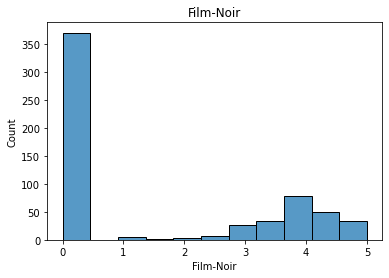

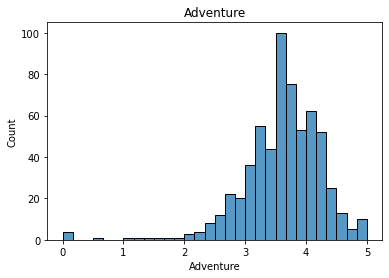

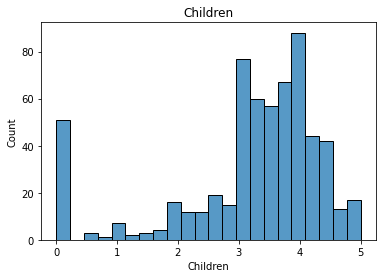

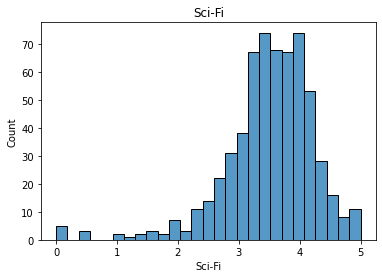

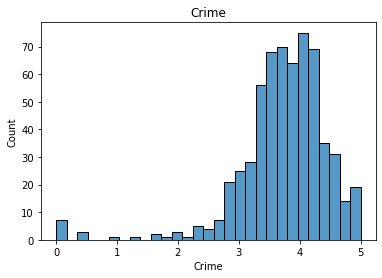

...

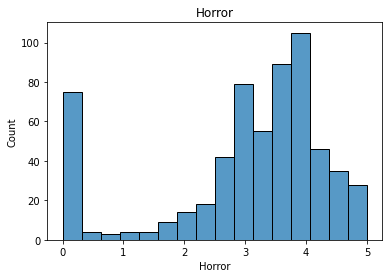

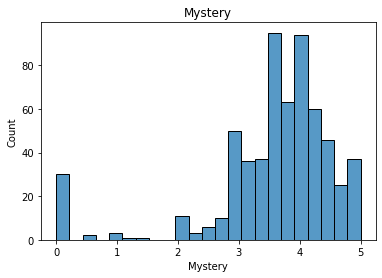

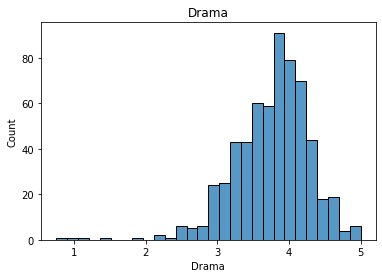

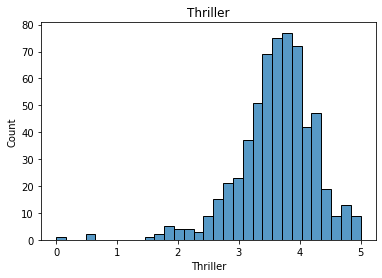

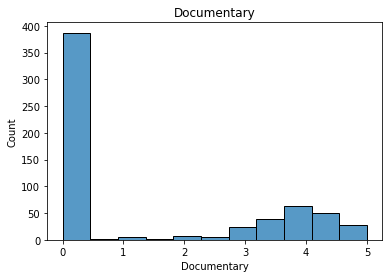

In [22]:
# Vemos la distribución de cada género
for var in df3:
    sns.histplot(df3[var])
    plt.title(var)
    plt.show()

<AxesSubplot:>

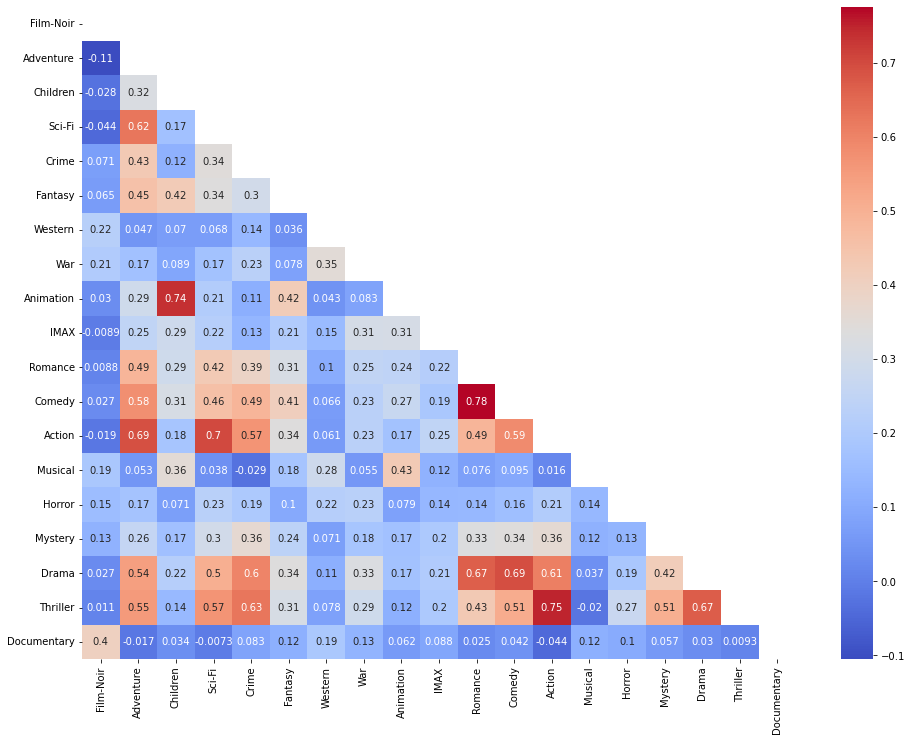

In [23]:
# Ploteamos la matriz de correlación
matrix_corr = df3.corr()
mask = np.triu(np.ones_like(matrix_corr, dtype=bool))
plt.figure(figsize = (16, 12))
sns.heatmap(matrix_corr, mask = mask, cmap = 'coolwarm', annot = True)

# Clustering

## Clustering con el subset de datos 1

In [24]:
training_dt = df2

### Método Elbow

Vamos a aplicar el metodo elbow para ver el numero ideal de clusters.

C:\Users\Laura\miniconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1036: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


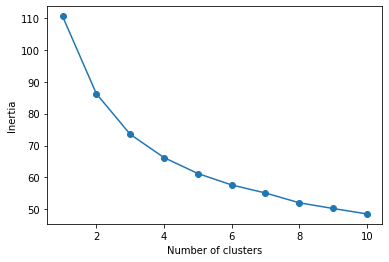

In [25]:
# Selection of the dataset
inertia = []

#Calculate the Kmeans from K=1 to 10
for i in range(1, 11):
    km = KMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=10,
        tol=1e-04, random_state=0
    )
    km.fit(training_dt)
    inertia.append(km.inertia_)

# plot
plt.plot(range(1, 11), inertia, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

Vemos que el método Elbow no ofrece un valor de k claro. Parece ser que el valor más adecuado tal vez se encontrase alrededor de 6 o 7, si bien éste es un número considerablemente elevado de clusters. 

Aplicamos el método Silhouette para tratar de hallar un valor de k más exacto. 

### Método Silhouette

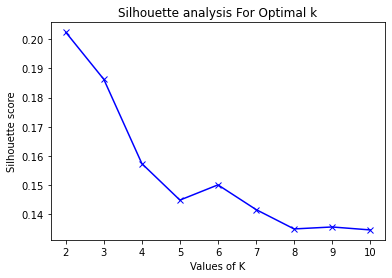

In [26]:
silhouette_avg = []
range_n_clusters = range(2, 11)

for num_clusters in range_n_clusters:
    labels = KMeans(init='random', n_clusters=num_clusters, n_init=10, tol=1e-04, random_state=0).fit_predict(training_dt.values)
    silhouette_avg.append(silhouette_score(training_dt, labels))

plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

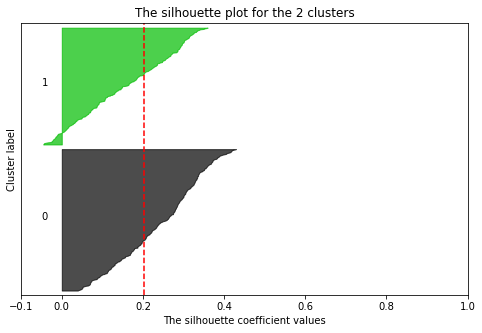

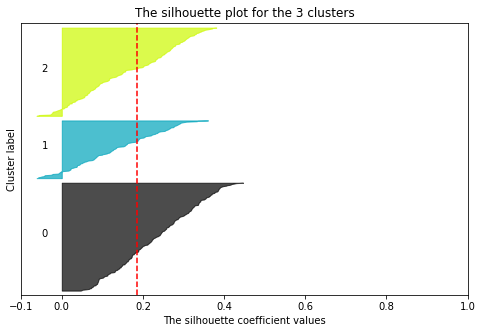

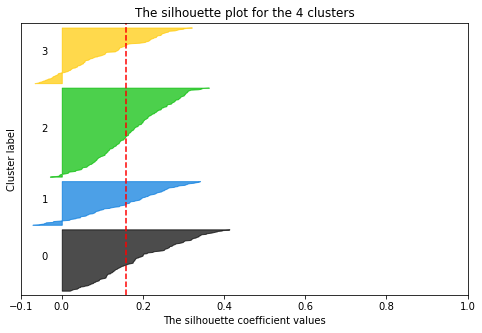

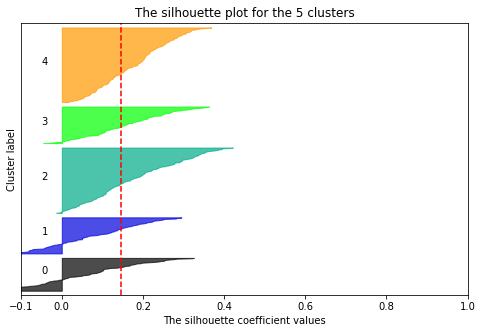

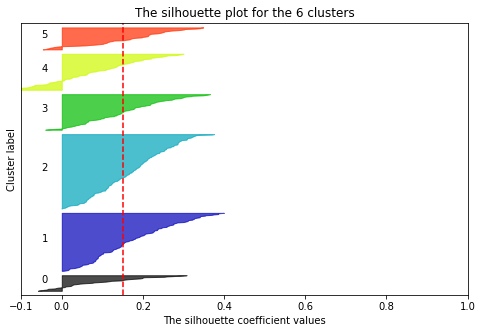

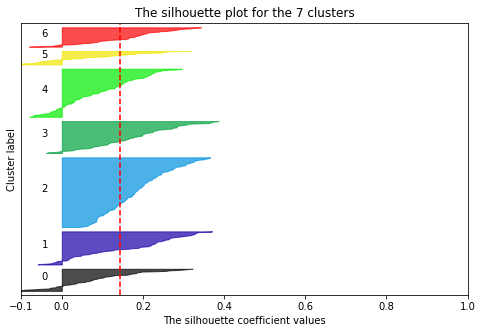

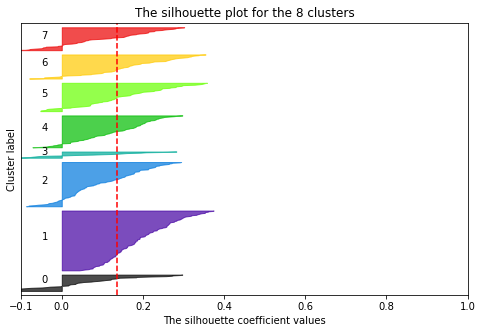

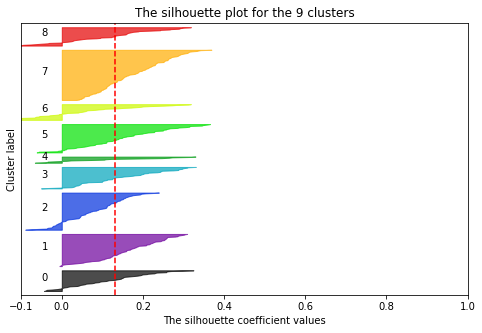

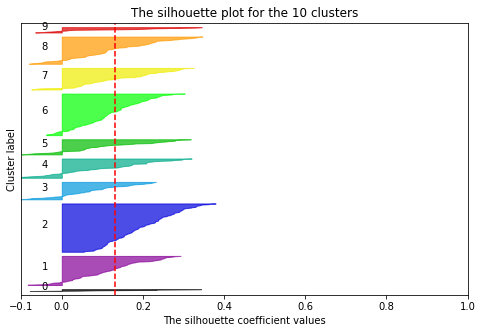

In [27]:
# Ploteamos el resultado de Silhouette para k entre 2 y 10

for j in range(2, 11):
    n_clusters=j
    km  = KMeans(j, random_state=10)
    cluster_labels = km.fit_predict(training_dt)
    silhouette_avg = silhouette_score(training_dt, cluster_labels)
    
    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(training_dt, cluster_labels)
    # Create a subplot with 1 row and 1 columns
    fig, (ax1) = plt.subplots(1,1)
    fig.set_size_inches(8, 5)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(training_dt) + (n_clusters + 1) * 10])
    
    y_lower = 10
    for i in range(j):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples
 
    ax1.set_title("The silhouette plot for the {} clusters".format(i+1))
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
plt.show()

Vemos que, aparentemente, la mejor opción es k entre 2 y 4.

### Clusterización con k = 2

In [28]:
# Generamos y entrenamos el modelo con 2 clusters
kmeans = KMeans(n_clusters = 2, init = 'random', n_init = 3, tol = 1.e-4, random_state=0).fit(training_dt)

# Etiquetamos los datos y los guardamos en un nuevo dataset
training_dt_kmeans = training_dt.copy()
training_dt_kmeans['label'] = kmeans.predict(training_dt)

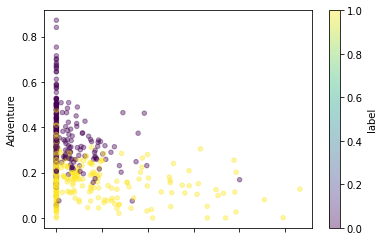

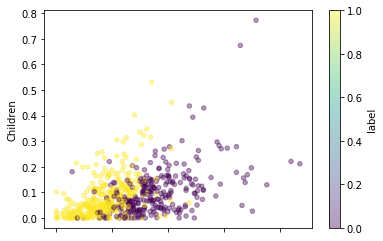

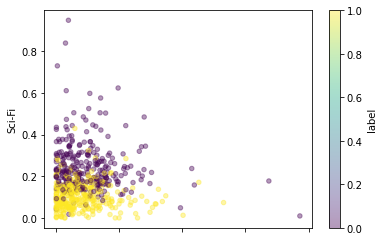

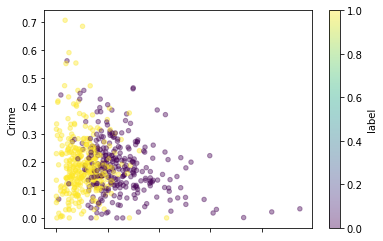

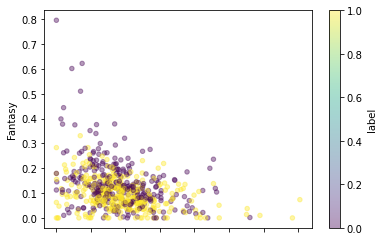

...

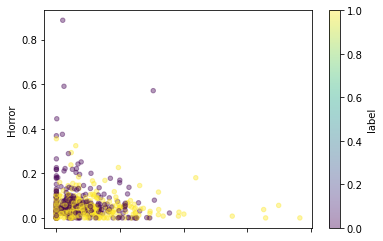

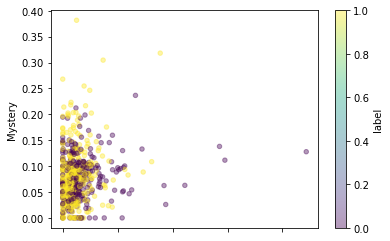

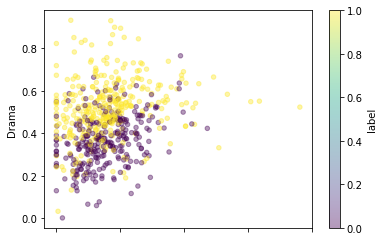

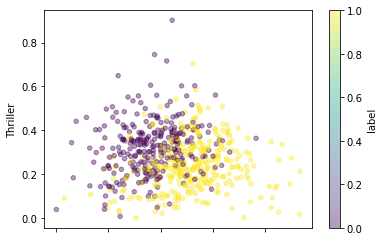

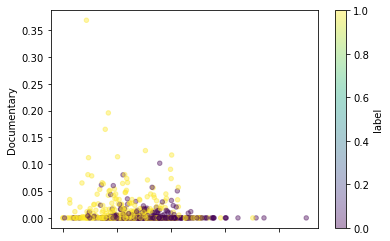

In [29]:
# Ploteamos la distribución de cada cluster en cada género
columns = training_dt.columns
for i in range(len(columns) - 1):
    training_dt_kmeans.plot.scatter(x = columns[i], y = columns[i + 1], c = 'label', colormap = 'viridis', alpha = 0.4)
    plt.show()

Parece que los tres géneros en que mejos se aprecian los dos clústers de ususarios son: *Children, Adventure, y SciFi*. Sin embargo, en el resto de géneros no se parecia una división clara de los usuarios por clústers. Repetimos el proceso, esta vez con 3 clusters. 

### Clusterización con k = 3

In [30]:
# Generamos y entrenamos el modelo con 3 clusters
kmeans = KMeans(n_clusters = 3, init = 'random', n_init = 3, tol = 1.e-4, random_state=0).fit(training_dt)

# Etiquetamos los datos y los guardamos en un nuevo dataset
training_dt_kmeans = training_dt.copy()
training_dt_kmeans['label'] = kmeans.predict(training_dt)

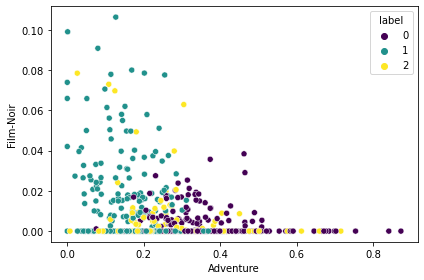

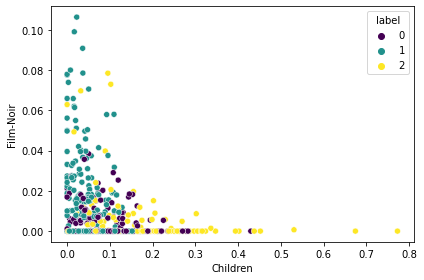

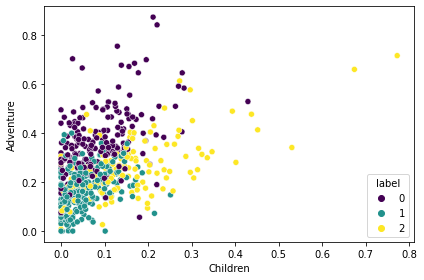

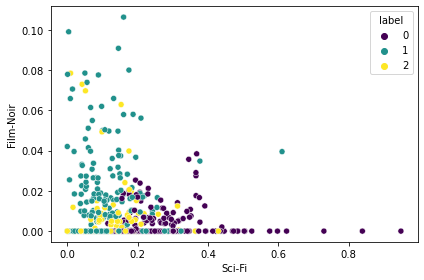

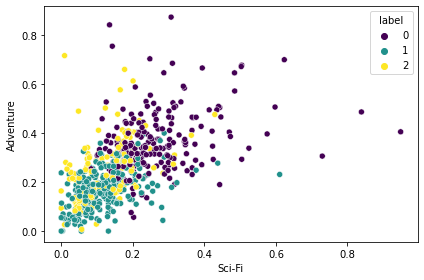

...

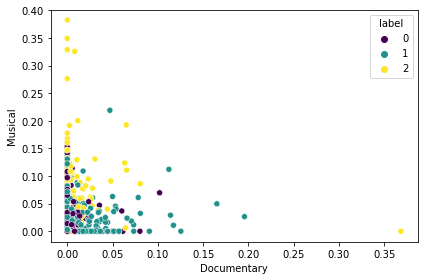

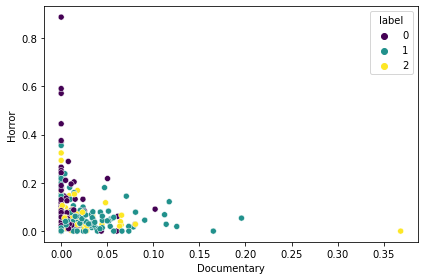

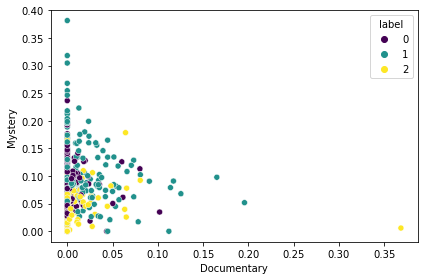

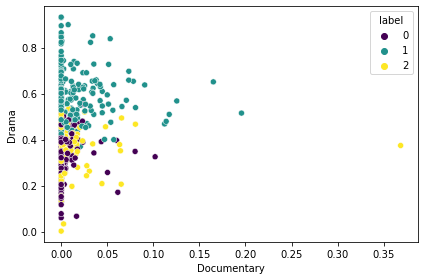

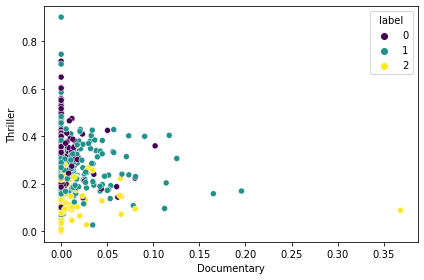

In [31]:
# Ploteamos los resultados por pares de géneros
for col1 in columns:
    for col2 in columns:
        if col1 == col2:
            break
        else:
            sns.scatterplot(data = training_dt_kmeans, x = col1, y = col2, hue = 'label', palette = 'viridis')
                   
            plt.tight_layout()
            plt.show()

De nuevo, no parece que hallemos grupos diferenciados entre los usuarios para la mayoría de los géneros. 

## Clustering con el subset de datos 2

### Método Elbow

In [32]:
# definismo el set de entrenamiento

training_dt2 = df3

C:\Users\Laura\miniconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1036: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


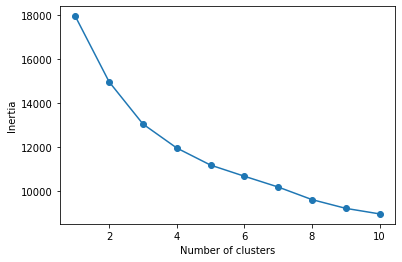

In [33]:
# Selection of the dataset
inertia2 = []

#Calculate the Kmeans from K=1 to 10
for i in range(1, 11):
    km = KMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=10,
        tol=1e-04, random_state=0
    )
    km.fit(training_dt2)
    inertia2.append(km.inertia_)

# plot
plt.plot(range(1, 11), inertia2, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

De nuevo, el método Elbow no aporta un valor de k óptimo claro. Aplicamos Silhouette

### Método Silhouette

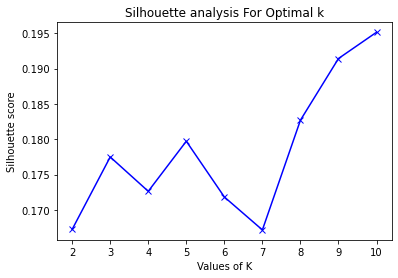

In [34]:
silhouette_avg2 = []
range_n_clusters = range(2, 11)

for num_clusters in range_n_clusters:
    labels = KMeans(init='random', n_clusters=num_clusters, n_init=10, tol=1e-04, random_state=0).fit_predict(training_dt2.values)
    silhouette_avg2.append(silhouette_score(training_dt2, labels))

plt.plot(range_n_clusters,silhouette_avg2,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

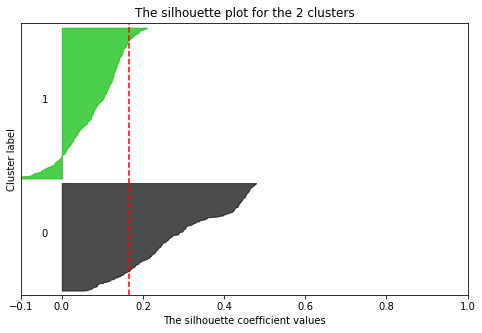

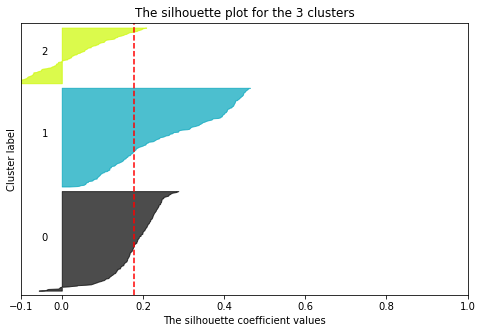

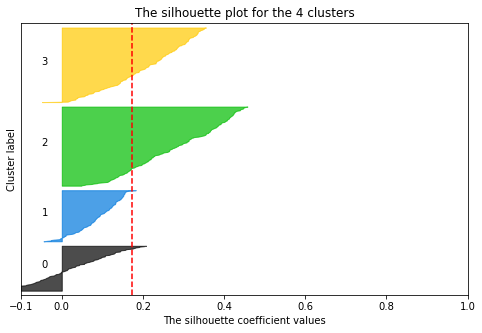

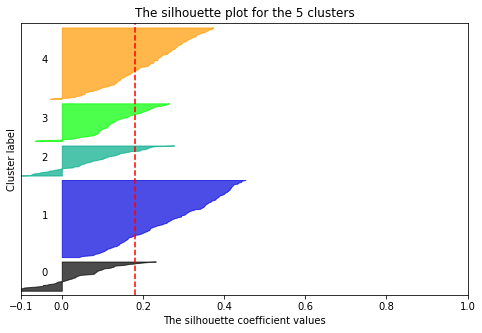

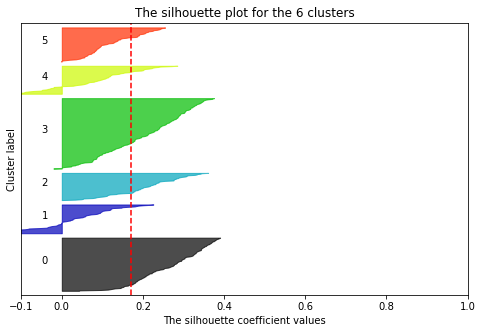

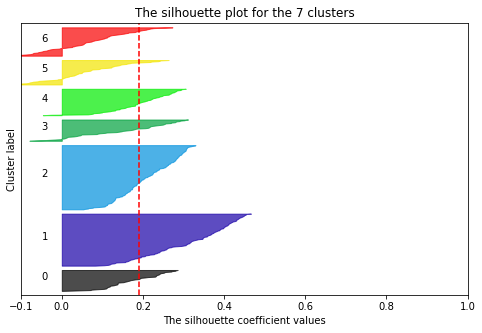

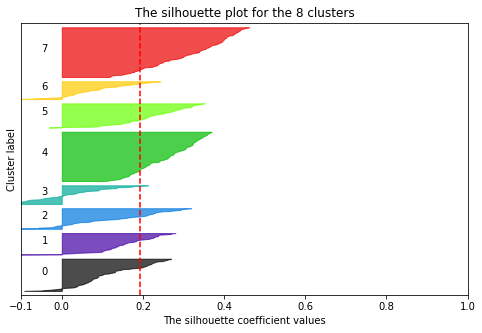

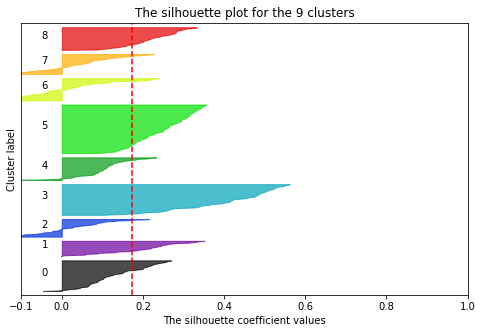

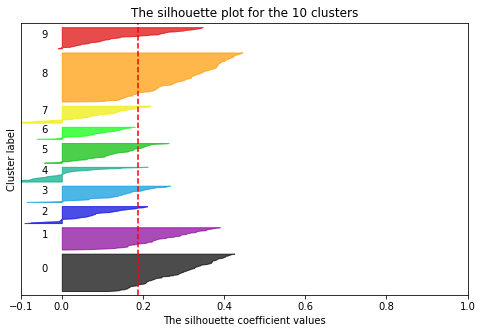

In [35]:
# Ploteamos el resultado de Silhouette para k entre 2 y 10

for j in range(2, 11):
    n_clusters=j
    km  = KMeans(j, random_state=10)
    cluster_labels = km.fit_predict(training_dt2)
    silhouette_avg = silhouette_score(training_dt2, cluster_labels)
    
    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(training_dt2, cluster_labels)
    # Create a subplot with 1 row and 1 columns
    fig, (ax1) = plt.subplots(1,1)
    fig.set_size_inches(8, 5)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(training_dt2) + (n_clusters + 1) * 10])
    
    y_lower = 10
    for i in range(j):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples
 
    ax1.set_title("The silhouette plot for the {} clusters".format(i+1))
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
plt.show()

Parece ser que tanto Silhouette como Elbow sugieren valord e k considerablemente elevados, aunque según lo que podemos apreciar en la gráfica de silouhette, un valor aceptable estaría en 5. 

Realizamos diferentes pruebas con diferentes valores de k. 

### Clusterización con k = 2

In [36]:
# Generamos y entrenamos el modelo con 2 clusters
kmeans = KMeans(n_clusters = 2, init = 'random', n_init = 3, tol = 1.e-4, random_state=0).fit(training_dt2)

# Etiquetamos los datos y los guardamos en un nuevo dataset
training_dt2_kmeans = training_dt2.copy()
training_dt2_kmeans['label'] = kmeans.predict(training_dt2)

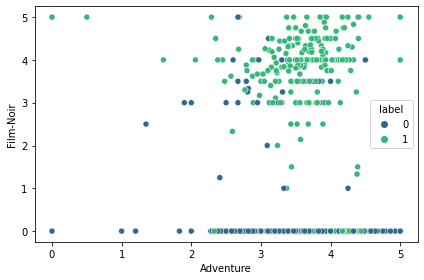

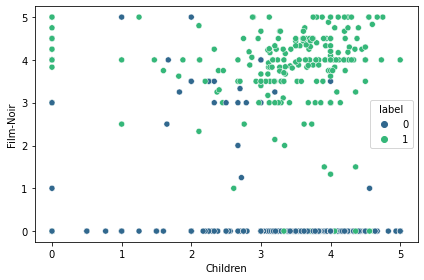

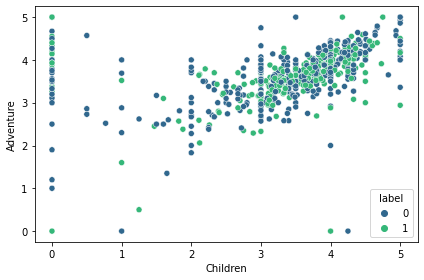

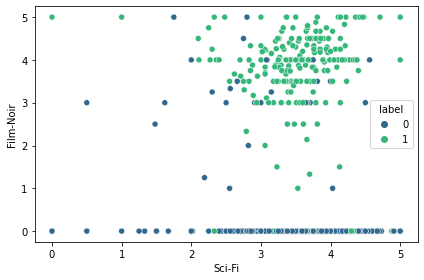

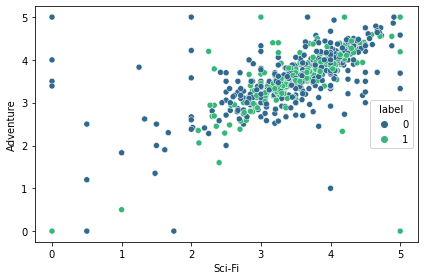

...

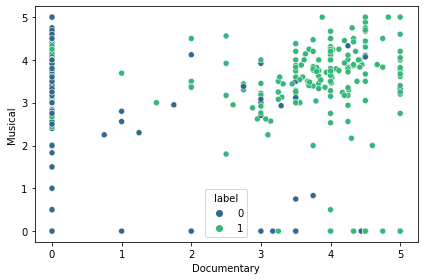

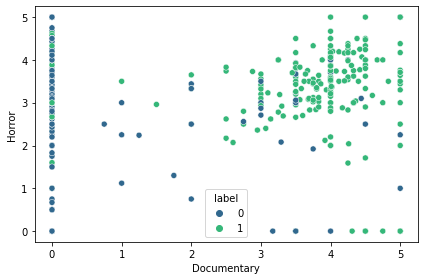

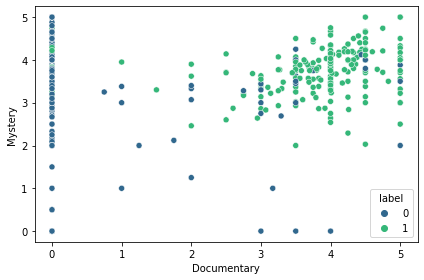

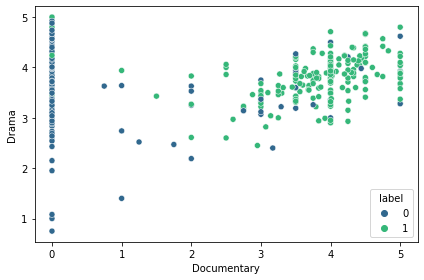

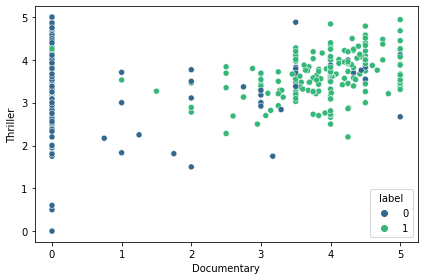

In [37]:
# Ploteamos los resultados por pares de géneros
for col1 in columns:
    for col2 in columns:
        if col1 == col2:
            break
        else:
            sns.scatterplot(data = training_dt2_kmeans, x = col1, y = col2, hue = 'label', palette = 'viridis')
                   
            plt.tight_layout()
            plt.show()

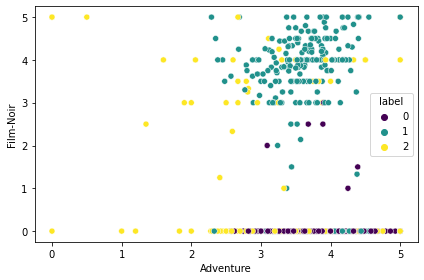

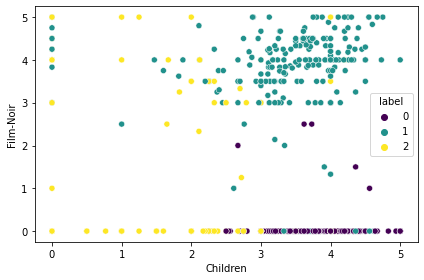

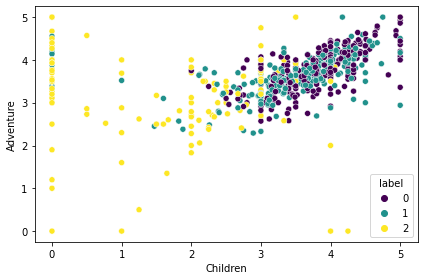

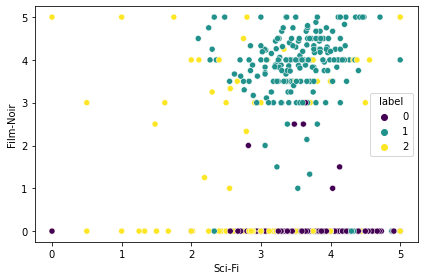

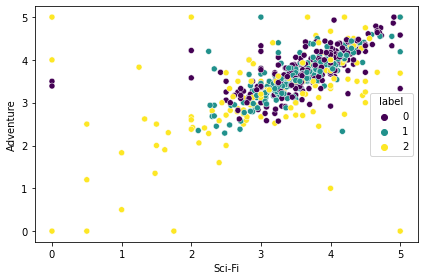

...

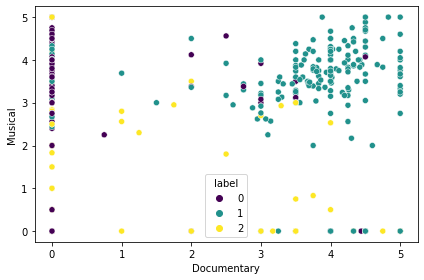

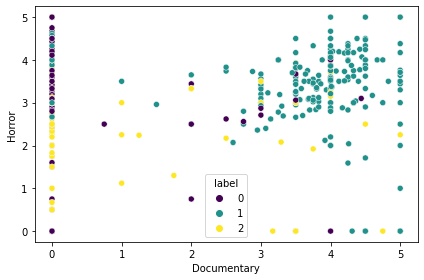

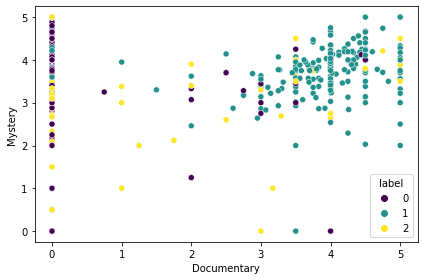

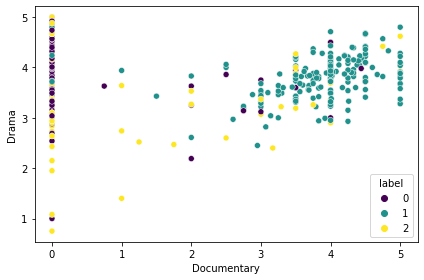

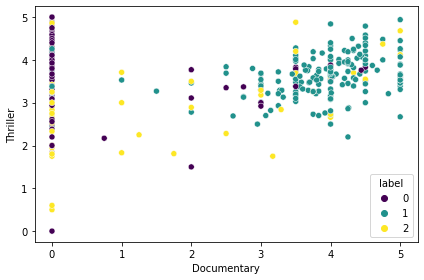

In [38]:
# Generamos y entrenamos el modelo con 2 clusters
kmeans = KMeans(n_clusters = 3, init = 'random', n_init = 3, tol = 1.e-4, random_state=0).fit(training_dt2)

# Etiquetamos los datos y los guardamos en un nuevo dataset
training_dt2_kmeans = training_dt2.copy()
training_dt2_kmeans['label'] = kmeans.predict(training_dt2)

for col1 in columns:
    for col2 in columns:
        if col1 == col2:
            break
        else:
            sns.scatterplot(data = training_dt2_kmeans, x = col1, y = col2, hue = 'label', palette = 'viridis')
                   
            plt.tight_layout()
            plt.show()

### Clusterización con k = 5

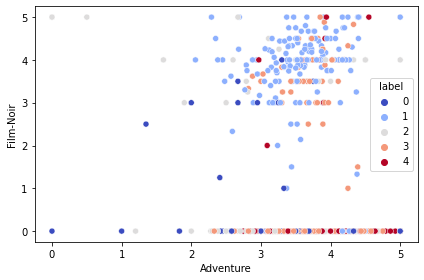

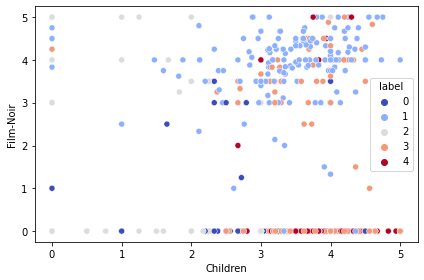

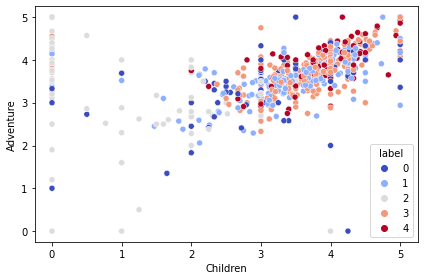

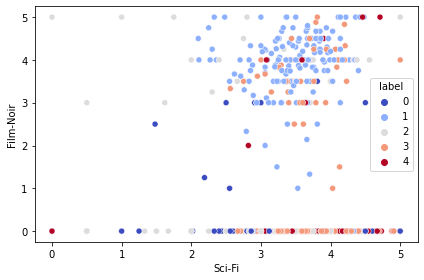

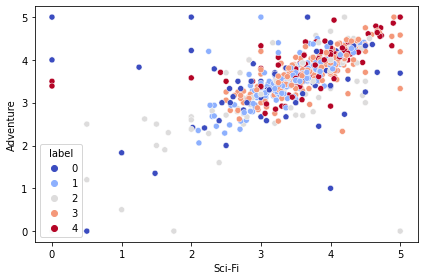

...

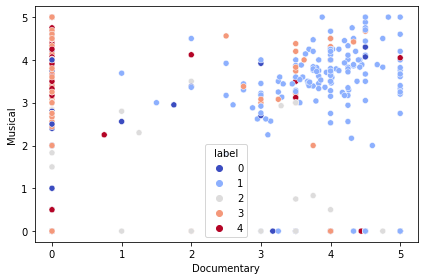

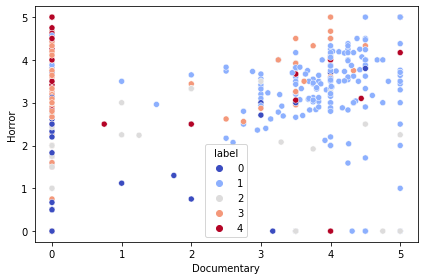

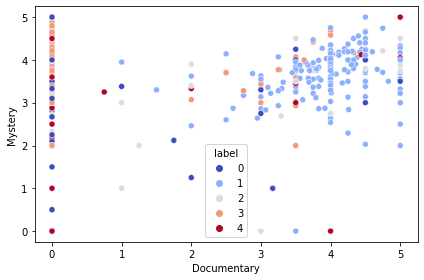

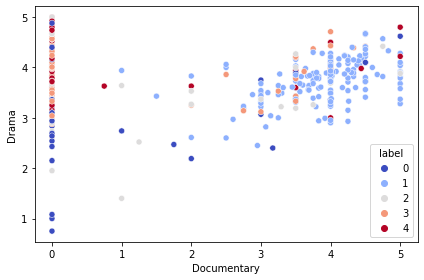

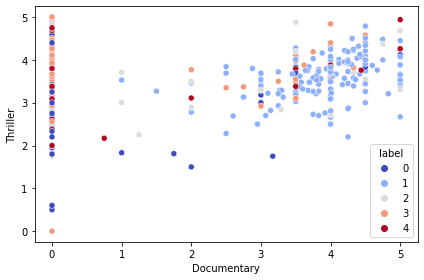

In [39]:
# Generamos y entrenamos el modelo con 2 clusters
kmeans = KMeans(n_clusters = 5, init = 'random', n_init = 3, tol = 1.e-4, random_state=0).fit(training_dt2)

# Etiquetamos los datos y los guardamos en un nuevo dataset
training_dt2_kmeans = training_dt2.copy()
training_dt2_kmeans['label'] = kmeans.predict(training_dt2)

for col1 in columns:
    for col2 in columns:
        if col1 == col2:
            break
        else:
            sns.scatterplot(data = training_dt2_kmeans, x = col1, y = col2, hue = 'label', palette = 'coolwarm')
                   
            plt.tight_layout()
            plt.show()

De nuevo, no parece que hallemos clusters claros. Sí que parece ser que hay un cluster que incluye a personas que puntúan alto los documentales, los cuales parecen tener afinidad también por géneros como el cine negro, la fantasía, los musicales, el crimen y la acción. Por lo demás, más que clusters lo que parece que estamos viendo son ciertos géneros afines entre ellos, es  decir, que a las personas que les gusta un género también les gusta otro. Por ejemplo, vemos que las personas que puntúan alto las películas de crimen también puntúan alto las películas de drama, y que las personas que puntúan alto los thrillers también suelen puntuar alto las películas de acción, de horror, y el drama. En la misma línea, las personas que puntúan alto las películas de acción suelen puntuar alto las películas de aventuras, y las personas a las que les gusta el misterio pareciera que también les gusta el IMAX. Vemos también que a las personas que les gusta el film noir no les suele gustar la ciencia ficción, las aventuras, la animación y las películas de acción.

Podríamos pensar que, por tanto, las personas tienen preferencia por ciertos géneros concretos, que son los que más ven y, por tanto, los que más puntúan, puesto que sería extraño que una persona puntuara (y viera) muchas películas de géneros que no le gustan. Así, podríamos probar un abordaje de clusterización basado en el número de ratings emitidos en lugar de en la media de ratings por género, para tratar de hallar grupos que miran ciertos géneros concretos y, posteriormente, ofrecer recomendaciones en base a los ratings de las películas de esos géneros (por ejemplo, si vieramos que las personas que miran sobre todo películas del género crimen también miran películas del género drama, pordríamos recomendarles les películas de estos dos géneros que mejores ratings obtengan).

## Clusterización basada en la frecuencia de ratings

In [40]:
frequencies.head()

,Film-Noir,Adventure,Children,Sci-Fi,Crime,Fantasy,Western,War,Animation,IMAX,Romance,Comedy,Action,Musical,Horror,Mystery,Drama,Thriller,Documentary
userId,,,,,,,,,,,,,,,,,,,
1,1,85,42,40,45,47,7,22,29,0,26,83,90,22,17,18,68,55,0
2,0,3,0,4,10,0,1,1,0,4,1,7,11,0,1,2,17,10,3
3,0,11,5,15,2,4,0,5,4,0,5,9,14,1,8,1,16,7,0
4,4,29,10,12,27,19,10,7,6,1,58,104,25,16,4,23,120,38,2
5,0,8,9,2,12,7,2,3,6,3,11,15,9,5,1,1,25,9,0


<AxesSubplot:>

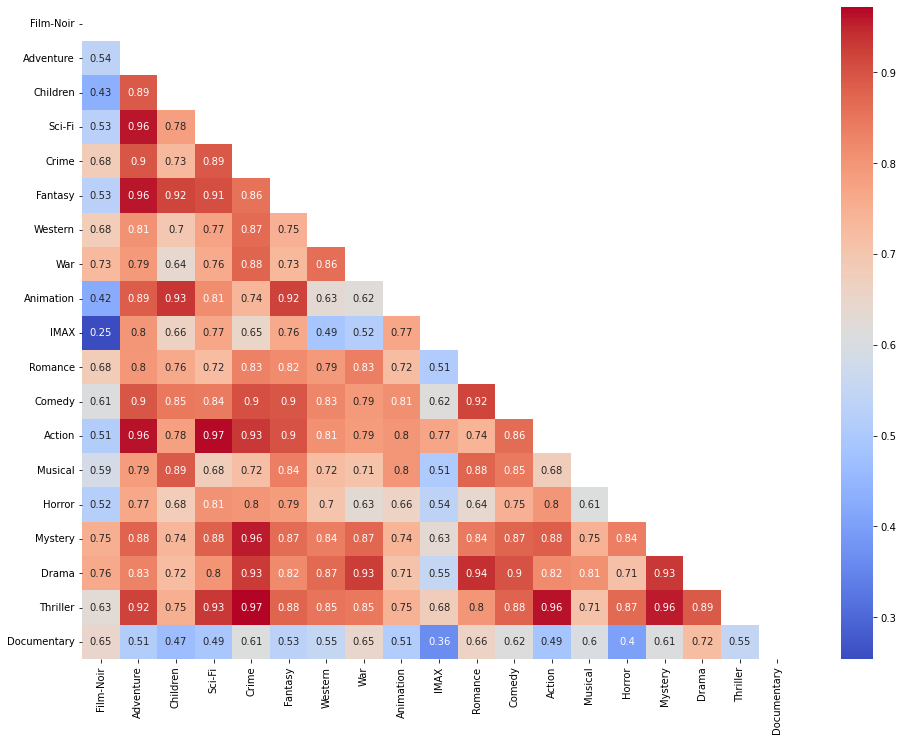

In [41]:
# Ploteamos la matriz de correlación
matrix_corr = frequencies.corr()
mask = np.triu(np.ones_like(matrix_corr, dtype=bool))
plt.figure(figsize = (16, 12))
sns.heatmap(matrix_corr, mask = mask, cmap = 'coolwarm', annot = True)

Vemos que, efectivamente, hay géneros que están muy correlacionados, mientras que otros lo están considerablemente menos. 
Aplicamos el método Elbow y Silhouette, y posteriormente realizamos los clusters

C:\Users\Laura\miniconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1036: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


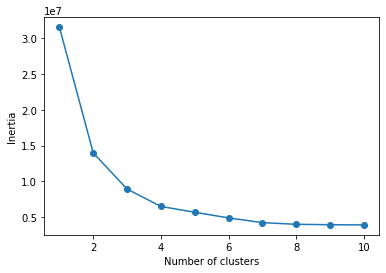

In [42]:
# Aplicamos el método Elbow
training_dt3 = frequencies.copy()
inertia3 = []

#Calculate the Kmeans from K=1 to 10
for i in range(1, 11):
    km = KMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=10,
        tol=1e-04, random_state=0
    )
    km.fit(training_dt3)
    inertia3.append(km.inertia_)

# plot
plt.plot(range(1, 11), inertia3, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

Parece que obtenemos un valor de k óptimo más claro, situado entre k = 3 o k = 4. 

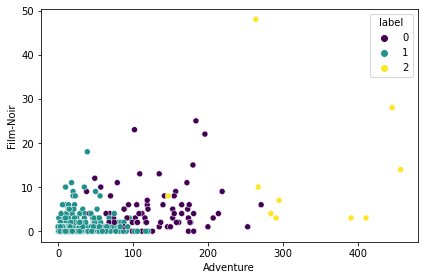

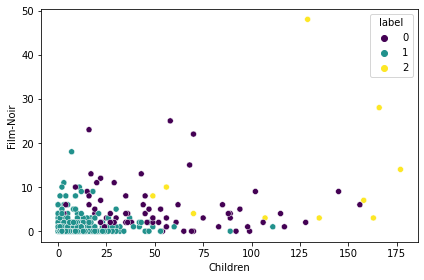

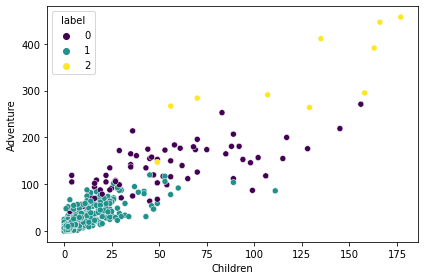

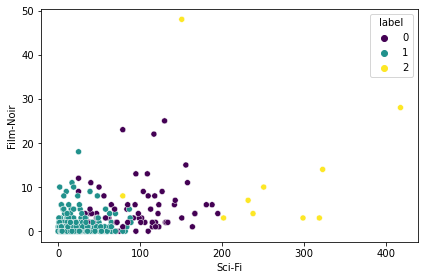

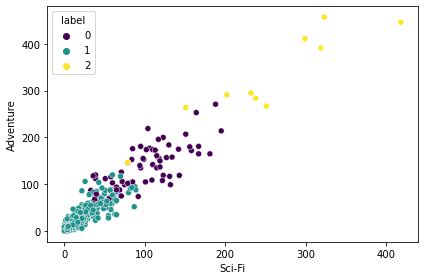

...

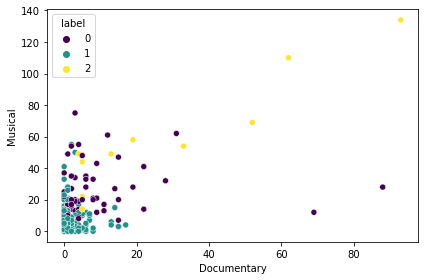

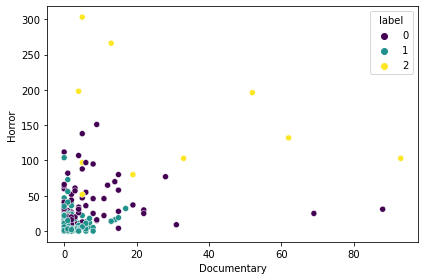

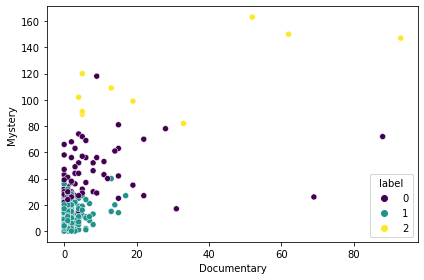

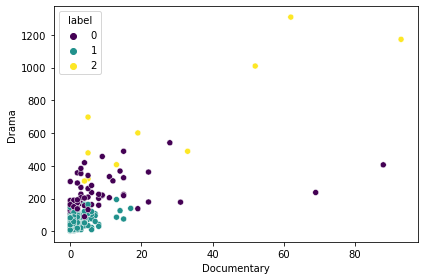

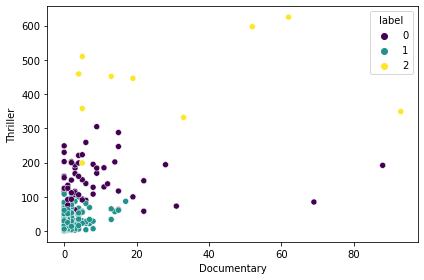

In [43]:
# Generamos y entrenamos el modelo con 3 clusters
kmeans = KMeans(n_clusters = 3, init = 'random', n_init = 3, tol = 1.e-4, random_state=0).fit(training_dt3)

# Etiquetamos los datos y los guardamos en un nuevo dataset
training_dt3_kmeans = training_dt3.copy()
training_dt3_kmeans['label'] = kmeans.predict(training_dt3)

for col1 in columns:
    for col2 in columns:
        if col1 == col2:
            break
        else:
            sns.scatterplot(data = training_dt3_kmeans, x = col1, y = col2, hue = 'label', palette = 'viridis')
                   
            plt.tight_layout()
            plt.show()

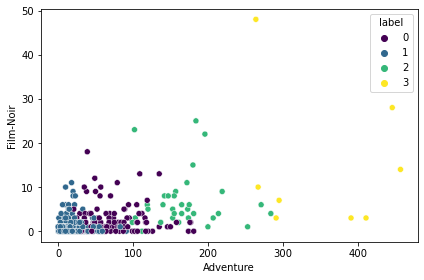

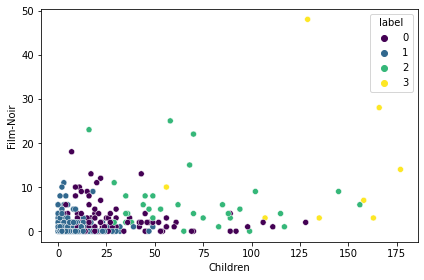

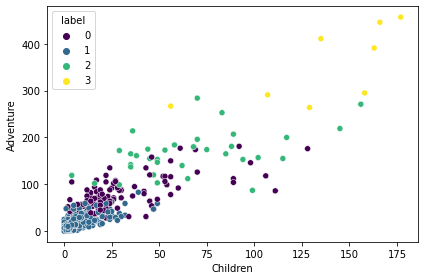

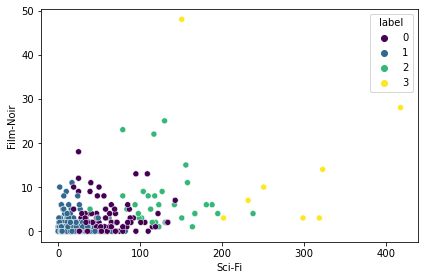

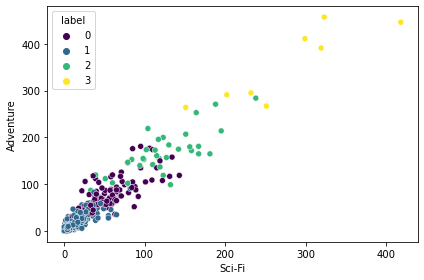

...

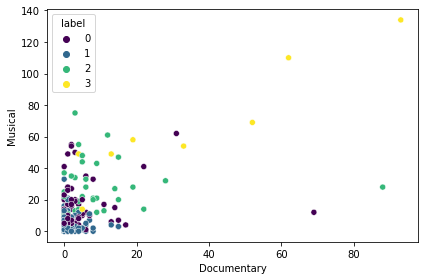

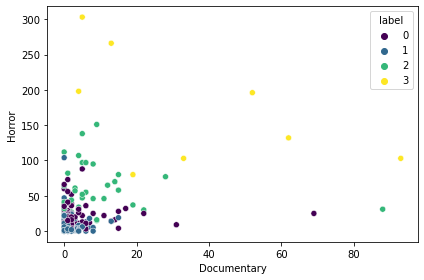

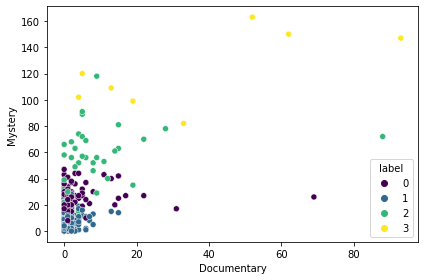

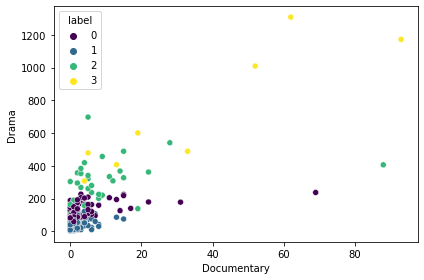

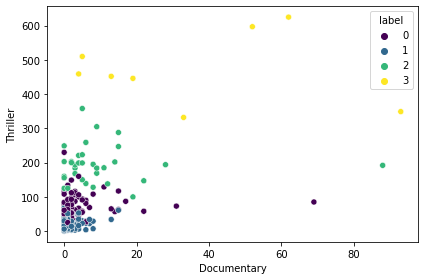

In [44]:
# Probamos con 4 clusters
kmeans = KMeans(n_clusters = 4, init = 'random', n_init = 3, tol = 1.e-4, random_state=0).fit(training_dt3)

# Etiquetamos los datos y los guardamos en un nuevo dataset
training_dt3_kmeans = training_dt3.copy()
training_dt3_kmeans['label'] = kmeans.predict(training_dt3)

for col1 in columns:
    for col2 in columns:
        if col1 == col2:
            break
        else:
            sns.scatterplot(data = training_dt3_kmeans, x = col1, y = col2, hue = 'label', palette = 'viridis')
                   
            plt.tight_layout()
            plt.show()

Como podemos ver, esta aproximación no parece funcionar, pues lo que estamos bien parecer ser más grupos de usuarios según su frecuencia de puntuaciones, independientemente de los géneros puntuados. Es decir, estamos viendo un grupo de personas que han puntuado pocas películas en general, un grupo que ha puntuado muchas películas en general, y dos grupos intermedio. 

## PCA

Vamos a aplicar PCA para tratar de hallar mejores varibles discriminativas de los diferentes grupos. 

In [45]:
# Normalizamos los datos
scaler = StandardScaler()
scaled_features = scaler.fit_transform(training_dt)

# Aplicamos PCA al primer conjunto de datos, en un primer lugar pidíendole únicamente 2 componentes
pca = PCA(n_components = 2, random_state = 42)
principal_components = pca.fit_transform(scaled_features)

print('The 2 first compononents explain {}% of data variance'.format(100*pca.explained_variance_ratio_.sum()))

The 2 first compononents explain 43.23957977933215% of data variance


In [46]:
# Realizamos diferentes pruebas hasta obtener, al menos, un 80% de la varianza

pca = PCA(n_components = 8, random_state = 42)
principal_components = pca.fit_transform(scaled_features)

print('The 2 first compononents explain {}% of data variance'.format(100*pca.explained_variance_ratio_.sum()))

The 2 first compononents explain 81.08811600882932% of data variance


No podemos hacer el analisis con PCA ya que la reducción de dimensionalidad nos hace perder demasiada información. Para explicar el 81% de la varianza, necesitamos 8 componentes, teniendo en origen 19 variables. Por tanto, no tiene demasiado sentido aplicar PCA. 

# Gaussian Mixture

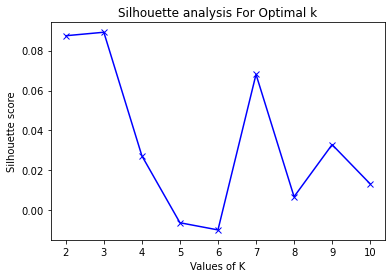

In [47]:
silhouette_avg = []
range_n_clusters = range(2, 11)

for num_clusters in range_n_clusters:
    labels = GaussianMixture(n_components=num_clusters, random_state=0).fit(training_dt).fit_predict(training_dt.values)
    silhouette_avg.append(silhouette_score(training_dt, labels))

plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

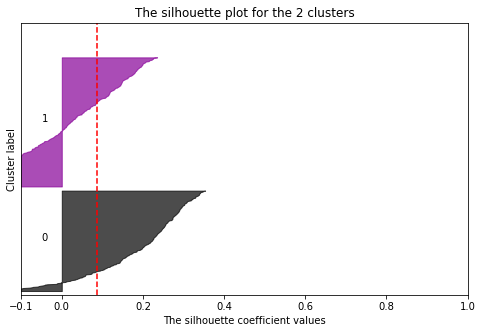

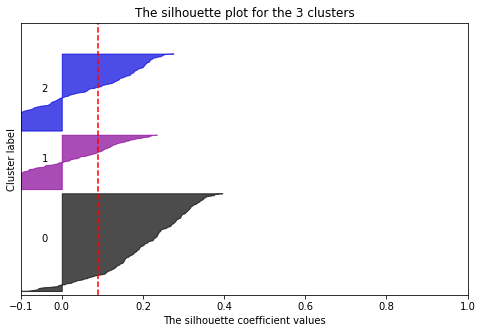

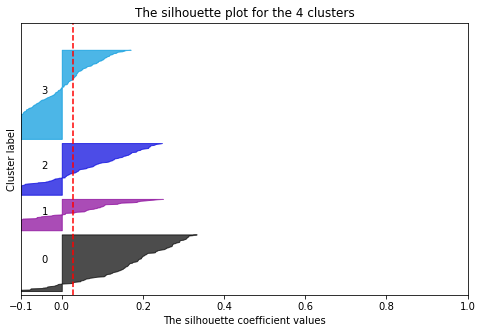

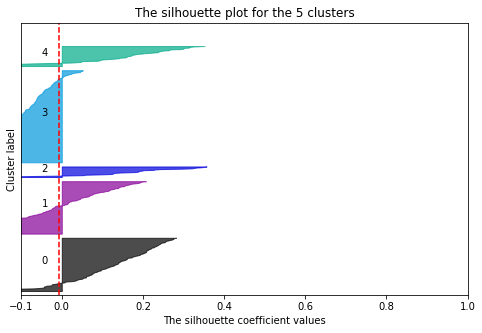

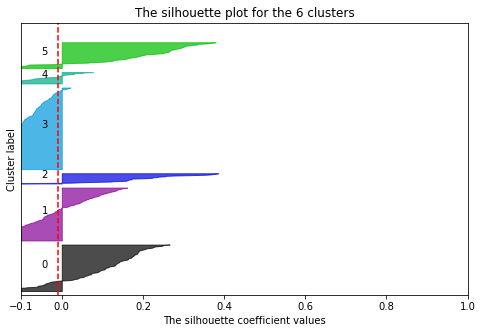

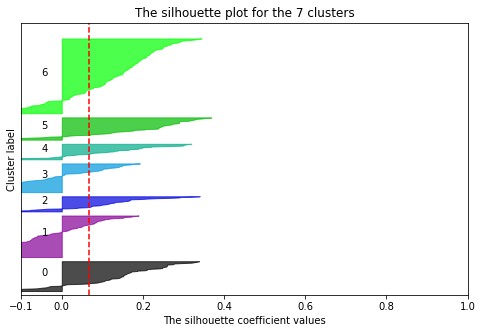

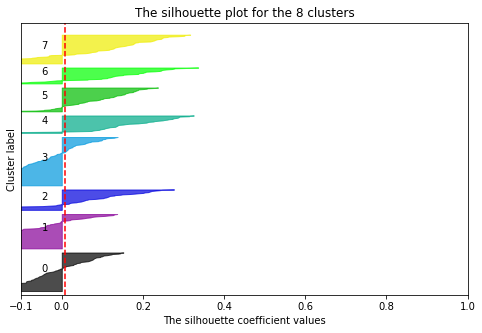

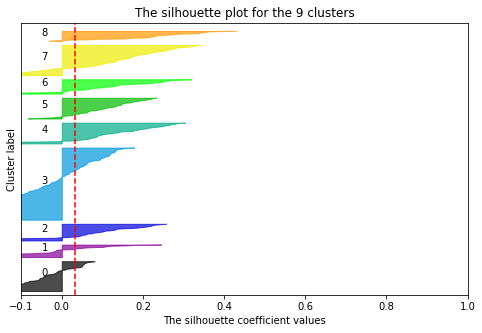

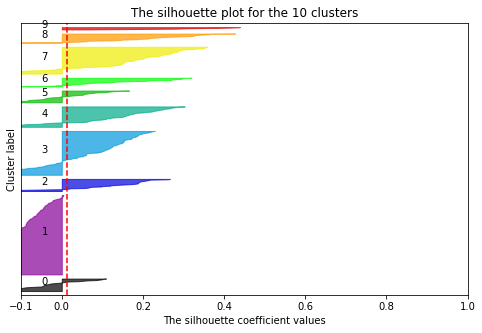

In [48]:
# Selection of the dataset

for j in range(2, 11):
    cluster_labels = GaussianMixture(n_components=j, random_state=0).fit_predict(training_dt)
    silhouette_avg = silhouette_score(training_dt, cluster_labels)
    
    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(training_dt, cluster_labels)
    # Create a subplot with 1 row and 1 columns
    fig, (ax1) = plt.subplots(1,1)
    fig.set_size_inches(8, 5)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(training_dt) + (n_clusters + 1) * 10])
    
    y_lower = 10
    for i in range(j):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples
 
    ax1.set_title("The silhouette plot for the {} clusters".format(i+1))
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
plt.show()

El modelo de Gaussian mixture da unos silhouette scores bastante peores asi que a priori parece que la clasificacion que hace es peor que la de k-means.

# Clusterización final

De todo lo ensayado hasta el momento, y analizando los gráficos de dispersión, parece que el mejor método, aun sin ser óptimo, ha sido la clusterización con k = 3 y el set de datos con las medias ponderadas teniendo en cuenta todas las películas para cada género, las haya puntuado el usuario o no. Por tanto, realizamos la clusterización final con él.

In [49]:
# Realizamos la clusterización final

km_final = KMeans(n_clusters=3, init='random', n_init=10, max_iter=10,
        tol=1e-04, random_state=0 )
labels_final = km_final.fit_predict(training_dt)

In [50]:
# Vemos cuántos usuarios tenemos en cada clúster
training_dt['Cluster'] = labels_final
training_dt['Cluster'].value_counts()

1    262
0    207
2    141
Name: Cluster, dtype: int64

## Decision Tree

Ahora que ya tenemos una clasificación, vamos a aplicar un decision tree para tratar de ver el rendimiento de la clusterización y las variables que está siguiendo.

In [51]:
# Definimos el modelo
dt = DecisionTreeClassifier(max_leaf_nodes = 4)

# Aislamos la variable target y dividimos el set en train y test
y = training_dt.pop('Cluster')

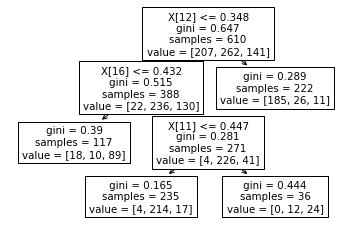

X[0] =  Film-Noir 	 X[5] =  Fantasy 	 X[14] =  Horror


In [52]:
# Aplicamos cross validation para evaluar el modelo
cross_val_score(dt, training_dt, y, cv=10)

# Entrenamos el modelo
dt.fit(training_dt, y)
tree.plot_tree(dt)
plt.show()
print('X[0] = ', training_dt.columns[0], '\t X[5] = ', training_dt.columns[5], '\t X[14] = ', training_dt.columns[14] )

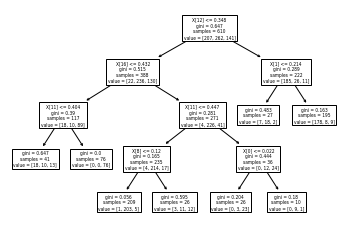

X[0] =  Film-Noir 	 X[5] =  Fantasy 	 X[14] =  Horror 	 X[12] =  Action


In [53]:
# Probamos aumentando el número de hojas a 8
# Definimos el modelo
dt = DecisionTreeClassifier(max_leaf_nodes = 8)
cross_val_score(dt, training_dt, y, cv=10)

# Entrenamos el modelo
dt.fit(training_dt, y)
tree.plot_tree(dt)
plt.show()
print('X[0] = ', training_dt.columns[0], '\t X[5] = ', training_dt.columns[5], '\t X[14] = ', training_dt.columns[14],'\t X[12] = ', training_dt.columns[12])

In [54]:
# Evaluación del modelo: lo aplicamos a X test
# y extraemos las probabilidades que predice el modelo a partir de las cuales clasifica

predictions_dt = dt.predict(training_dt)
probability_st = dt.predict_proba(training_dt)

In [55]:
print('AUC: ', metrics.accuracy_score(y, predictions_dt))
print('Precision: ', metrics.precision_score(y, predictions_dt, average = 'weighted'))
print('Recall: ', metrics.recall_score(y, predictions_dt,  average = 'weighted'))

AUC:  0.8803278688524591
Precision:  0.8838492480832525
Recall:  0.8803278688524591


## Sistema de recomendacion

Con los usuarios segmentados en clusters nos queamos con los usuarios de un mismo cluster, hacemos un left join con la tabla de peliculas y de hay sacamos el average score para cada pelicula y cuantas valoraciones tiene. Ordenamos las peliculas por popularidad dentro del cluster, donde la popularidad sera una combinacion de valoraciones y numero de botos, incluso podemos usar el tiempo medio de los botos para saber si la popularidad es muy antigua o no.

Con este metodo tenemos el problema que las pelicualas que no haya visto nadie del cluster no se van a poder recomendar entre ellos y esto incluie a las peliculas nuevas.

Para solventar este problema podemos usar otro metodo donde hacemos un cluster de las peliculas y calculamos la affinidad de cada cluster de usuarios con cada cluster de peliculas con un sistema similar al de antes, usando la media y numero de botos.

Con este metodo recomendamos los clusters de peliculas y las peliculas que no tengan valoraciones de ningun usuario del cluster pero esten en un cluster de peliculas que sea afin con el cluster de usuarios tambien se va a recomendar.